<div class="usecase-title">Public Event Planning</div>

<div class="usecase-authors"><b>Authored by: </b> Samiha Haque</div>

<div class="usecase-duration"><b>Duration:</b> 90 mins</div>

<div class="usecase-level-skill">
    <div class="usecase-level"><b>Level: </b>Intermediate</div>
    <div class="usecase-skill"><b>Pre-requisite Skills: </b>Python, Data Visualization, Data Wrangling, Machine Learning Models, Geographical Coordinate Handling</div>
    
</div>

<div class="usecase-section-header">Scenario</div>

- As an event planner, I want to know the locations of past public events so that I can run my own public events - sport/promotion/music/filming/photo shoot/memorial/public holiday with ease.

- As an event planner, I want to know about available parking areas near the events so that my guests can park their cars with ease.

- As an event planner,

<div class="usecase-section-header">What this use case will teach you</div>

At the end of this use case you will:
- {list the skills demonstrated in your use case}

<div class="usecase-section-header"><b>Business Friendy and Digitally Connected City</b></div>

The two of the eight priorities of the Economic Development Strategy 2031 of the city of Melbourne is to create a business friendly city and to develop a digitally connected city. By supporting businesses like event planning will help to drive the economy recovery and also help to map and connect public events, parkings and promotions through out the city of Melboune.

Datasets used:

- Event permits 2014-2018 including film shoots, photo shoots, weddings, Christmas parties, promotions, fun runs and public events
- On-street Parking Bay Sensors
- Bookable Banner Poles

In [62]:
!pip install geopy

     |████████████████████████████████| 125 kB 5.0 MB/s eta 0:00:01
     |████████████████████████████████| 40 kB 13.2 MB/s eta 0:00:01


In [108]:
!pip install folium

     |████████████████████████████████| 100 kB 4.8 MB/s ta 0:00:01
     |████████████████████████████████| 56 kB 6.3 MB/s eta 0:00:011
     |████████████████████████████████| 133 kB 5.8 MB/s eta 0:00:01
  Attempting uninstall: MarkupSafe
    Found existing installation: MarkupSafe 1.1.1
    Uninstalling MarkupSafe-1.1.1:
      Successfully uninstalled MarkupSafe-1.1.1
  Attempting uninstall: jinja2
    Found existing installation: Jinja2 2.11.3
    Uninstalling Jinja2-2.11.3:
      Successfully uninstalled Jinja2-2.11.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
anaconda-project 0.10.1 requires ruamel-yaml, which is not installed.
cookiecutter 1.7.2 requires Jinja2<3.0.0, but you have jinja2 3.1.3 which is incompatible.
cookiecutter 1.7.2 requires MarkupSafe<2.0.0, but you have markupsafe 2.1.5 which is incompatible.


In [880]:
!pip install retrying
import retrying

In [965]:
#importing dependencies
import requests
import pandas as pd
import numpy as np
from datetime import datetime
from decimal import Decimal
from io import StringIO
import geopy
from geopy.geocoders import Nominatim
import folium
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from category_encoders.binary import BinaryEncoder

from sklearn.multioutput import MultiOutputRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import NearestNeighbors
from sklearn.neighbors import KNeighborsRegressor

In [4]:
base_url='https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'
dataset_id='bookable-banner-poles'
with open('/Users/samihahaque/Desktop/key.txt') as file:
    API_KEY=file.read()

url=f'{base_url}{dataset_id}/exports/csv'
params={'select':'*','limit':-1,'lang':'en','timezone':'UTC','api_key':API_KEY}

response=requests.get(url,params=params)

if response.status_code==200:
    url_content=response.content.decode('utf-8')
    banner_df=pd.read_csv(StringIO(url_content),delimiter=';')
    print(banner_df.head(10))
else:
    print(f'Request failed with status code {response.status_code}')

   asset_number                                  asset_description  \
0       1110368  Standard Banner Pole - Lansdowne St: Wellingto...   
1       1110057                    Banner Pole - Super Banner Pole   
2       1110093                    Banner Pole - Super Banner Pole   
3       1110096                    Banner Pole - Super Banner Pole   
4       1110108                    Banner Pole - Super Banner Pole   
5       1350904                    Banner Pole - Super Banner Pole   
6       1110027                    Banner Pole - Super Banner Pole   
7       1110286  Super Banner Pole - Bourke St: Exhibition St -...   
8       1110544  Standard Banner Pole - Lonsdale St: Elizabeth ...   
9       1110418  Standard Banner Pole - Errol St: Victoria St -...   

   banner_pole_type  book_group             model_descr_lupvalue  \
0               6.0        62.0    Banner Pole - Standard Banner   
1               2.0        79.0  Banner Pole - Super Banner Pole   
2               2.0      

In [948]:
base_url='https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'
dataset_id='on-street-parking-bay-sensors'
with open('/Users/samihahaque/Desktop/key.txt') as file:
    API_KEY=file.read()

url=f'{base_url}{dataset_id}/exports/csv'
params={'select':'*','limit':-1,'lang':'en','timezone':'UTC','api_key':API_KEY}

response=requests.get(url,params=params)

if response.status_code==200:
    url_content=response.content.decode('utf-8')
    parking_df=pd.read_csv(StringIO(url_content),delimiter=';')
    print(parking_df.head(10))
else:
    print(f'Request failed with status code {response.status_code}')

                 lastupdated           status_timestamp  zone_number  \
0  2023-12-14T04:45:34+00:00  2023-12-14T03:41:25+00:00       7695.0   
1  2023-12-14T04:45:34+00:00  2023-12-13T06:21:58+00:00       7939.0   
2  2023-12-14T04:45:34+00:00  2023-12-13T07:44:31+00:00          NaN   
3  2023-12-14T23:45:34+00:00  2023-12-14T23:35:02+00:00          NaN   
4  2023-12-14T23:45:34+00:00  2023-12-14T22:39:46+00:00          NaN   
5  2023-12-18T04:45:34+00:00  2023-12-17T23:47:54+00:00       7310.0   
6  2023-12-18T04:45:34+00:00  2023-11-02T00:47:52+00:00       7050.0   
7  2023-12-18T04:45:34+00:00  2023-12-18T04:03:50+00:00       7310.0   
8  2023-12-18T04:45:34+00:00  2023-12-18T03:40:13+00:00       7310.0   
9  2023-11-15T04:44:42+00:00  2023-11-15T01:35:58+00:00       7363.0   

  status_description  kerbsideid                                 location  
0         Unoccupied       22959   -37.81844776554182, 144.95938672872117  
1         Unoccupied       10136    -37.8099909364941, 

In [217]:
base_url='https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'
dataset_id='event-permits-2014-2018-including-film-shoots-photo-shoots-weddings-christmas-pa'
with open('/Users/samihahaque/Desktop/key.txt') as file:
    API_KEY=file.read()

url=f'{base_url}{dataset_id}/exports/csv'
params={'select':'*','limit':-1,'lang':'en','timezone':'UTC','api_key':API_KEY}

response=requests.get(url,params=params)

if response.status_code==200:
    url_content=response.content.decode('utf-8')
    events_df=pd.read_csv(StringIO(url_content),delimiter=';')
    print(events_df.head(10))
else:
    print(f'Request failed with status code {response.status_code}')

                    title event_start   event_end       category_1  \
0         Holding The Man  2014-10-07  2014-10-07  Filming - Movie   
1  A Journey With Anthony  2015-03-07  2015-03-15  Filming - Movie   
2           Ali's Wedding  2015-12-03  2015-12-03  Filming - Movie   
3                Dogfight  2016-08-26  2016-08-27  Filming - Movie   
4               Old Timer  2016-04-20  2016-04-20  Filming - Movie   
5      Spirit Of The Game  2015-08-19  2015-08-20  Filming - Movie   
6                Dogfight  2016-09-17  2016-09-17  Filming - Movie   
7               Surya TVC  2014-04-26  2014-04-27  Filming - Other   
8           Threethousand  2014-05-06  2014-05-06  Filming - Other   
9        Loving Melbourne  2014-06-21  2014-06-21  Filming - Other   

            category_2                                           location  
0                  NaN                                       Fawkner Park  
1                  NaN       Other Park Locations, Inner Suburb Locations  
2

In [218]:
events_df.shape

(2827, 6)

In [219]:
events_df.nunique()

title          1877
event_start    1155
event_end      1150
category_1       34
category_2       11
location        619
dtype: int64

In [220]:
events_df[['category_1']].value_counts()

category_1                             
Wedding                                    615
Public Event - Non-ticketed                446
Promotion                                  430
Filming - TV Series                        200
Public Event - Run Walk                    165
Filming - TVC                              158
Public Event - Ticketed                    111
Public Event - Low Impact Activity          92
Filming - Photo shoot                       90
Private Event                               87
Filming - Unit Base                         58
Filming - Student                           57
Public Event - Non Ticketed                 56
Public Event - Music Event                  41
Filming - Other                             40
Public Event - Media/Launch Event           36
Public Event - Run/Walk                     33
Public Event - Memorial                     25
Filming - Movie                             21
Public Event - Cycling Event                19
Public Event - Parad

<b>Handling null values</b>

In [221]:
events_df.isna().sum() #category_2 has highest null values

title             0
event_start       0
event_end         4
category_1        0
category_2     2751
location          5
dtype: int64

In [222]:
events_df[events_df['category_2'].notnull()][['category_1','category_2']].value_counts()
#Not much difference found between category_1 and category_2 values

category_1                          category_2           
Private Event                       Christmas Party          46
Filming - TV Series                 Filming - Unit            7
Public Event - Non-ticketed         Public                    7
Filming - Movie                     Filming - Unit Base       4
Filming - Photo shoot               Filming - Other           2
Filming - TVC                       Filming - Photo shoot     2
Filming - Movie                     Filming - Student         1
Filming - Photo shoot               Public Event              1
Filming - TVC                       Filming - Other           1
                                    Filming - TV Series       1
                                    Filming - Unit Base       1
Private Event -                     Christmas Party           1
Public Event - Low Impact Activity  Filming                   1
Public Event - Non-ticketed         Recrea                    1
dtype: int64

In [224]:
events_df.drop(['title','category_2'],axis=1,inplace=True) #dropped category_2
events_df.head()

,event_start,event_end,category_1,location
0,2014-10-07,2014-10-07,Filming - Movie,Fawkner Park
1,2015-03-07,2015-03-15,Filming - Movie,"Other Park Locations, Inner Suburb Locations"
2,2015-12-03,2015-12-03,Filming - Movie,Inner Suburb Locations
3,2016-08-26,2016-08-27,Filming - Movie,"Flagstaff Gardens, Collins Street, Flinders La..."
4,2016-04-20,2016-04-20,Filming - Movie,Fawkner Park


In [225]:
events_df.isna().sum()

event_start    0
event_end      4
category_1     0
location       5
dtype: int64

In [226]:
events_df[events_df['event_end'].isna()]

,event_start,event_end,category_1,location
10,2014-12-08,NaN,Filming - Other,Russell Street
106,2016-02-25,NaN,Filming - TV Series Filming - TV Series,"Alexandra Gardens, Kings Domain, All Other Spa..."
418,2015-04-26,NaN,Public Event - Non-ticketed,City Square
1559,2017-04-02,NaN,Public Event - Ticketed,Kings Domain


In [227]:
events_df.dropna(axis=0,inplace=True) #drop rows which have null values

In [228]:
events_df.isna().sum()

event_start    0
event_end      0
category_1     0
location       0
dtype: int64

In [229]:
events_df.shape

(2818, 4)

<b>Creating single location names for corresponding category in each record</b>

In [239]:
category=events_df['category_1'].unique()
category_dict={}
for i in category:
    val=events_df.loc[events_df['category_1']==i,['location','event_start','event_end']]
    category_dict[i]=val

In [258]:
event_cat=[]
event_loc=[]
start_date=[]
end_date=[]
for i,j in category_dict.items():
    row=0
    for x in j['location']:
        if ", " in x:
            loc_lst=x.split(", ")
            for y in loc_lst:
                event_cat.append(i)
                start_date.append(j.iloc[row,1])
                end_date.append(j.iloc[row,2])
                event_loc.append(f"{y}, Melbourne, Australia")
        elif " - " in x:
            loc_lst=x.split(" - ")
            for y in loc_lst:
                event_cat.append(i)
                start_date.append(j.iloc[row,1])
                end_date.append(j.iloc[row,2])
                event_loc.append(f"{y}, Melbourne, Australia")
        else:
            event_cat.append(i)
            start_date.append(j.iloc[row,1])
            end_date.append(j.iloc[row,2])
            event_loc.append(f"{x}, Melbourne, Australia")
        row+=1

In [260]:
events_loc_df=pd.DataFrame({'Events': event_cat, 'Location': event_loc,'Start_date':start_date,'End_date':end_date})
events_loc_df.head(10)

,Events,Location,Start_date,End_date
0,Filming - Movie,"Fawkner Park, Melbourne, Australia",2014-10-07,2014-10-07
1,Filming - Movie,"Other Park Locations, Melbourne, Australia",2015-03-07,2015-03-15
2,Filming - Movie,"Inner Suburb Locations, Melbourne, Australia",2015-03-07,2015-03-15
3,Filming - Movie,"Inner Suburb Locations, Melbourne, Australia",2015-12-03,2015-12-03
4,Filming - Movie,"Flagstaff Gardens, Melbourne, Australia",2016-08-26,2016-08-27
5,Filming - Movie,"Collins Street, Melbourne, Australia",2016-08-26,2016-08-27
6,Filming - Movie,"Flinders Lane, Melbourne, Australia",2016-08-26,2016-08-27
7,Filming - Movie,"Little Collins Street, Melbourne, Australia",2016-08-26,2016-08-27
8,Filming - Movie,"Market Street, Melbourne, Australia",2016-08-26,2016-08-27
9,Filming - Movie,"Queen Street, Melbourne, Australia",2016-08-26,2016-08-27


In [261]:
events_loc_df.shape

(5132, 4)

<b>Converting location names to latitude,longitude coordinates using geolocator</b>

In [262]:
@retrying.retry(wait_fixed=2000, stop_max_attempt_number=5)
def coordinates(location):
    loc = geolocator.geocode(location)
    if loc:
        return loc.latitude, loc.longitude
    else:
        raise Exception("Geocoding failed")


lat=[]
lon=[]
used=[]

geolocator = Nominatim(user_agent="my_geocoder",timeout=5)


for i in events_loc_df['Location']:
    
    if i not in used:
        try:
            l1,l2=coordinates(i)
  
            if l2:
                lat.append(l1)
                lon.append(l2)
        except Exception as e:
            lat.append(i)
            lon.append(i)
            used.append(i)
    else:
        lat.append(i)
        lon.append(i)
    

In [263]:
len(lat),len(lon),len(event_cat)

(5132, 5132, 5132)

<b>New Dataframe with Category, Start_date, End_date, Latitude, Longitude and Location</b>

In [264]:
events_lat_lon = pd.DataFrame({'Category': event_cat,'Start_date':start_date,'End_date':end_date, 'Latitude': lat,'Longitude':lon,'Location':event_loc})

In [265]:
events_lat_lon.head()

,Category,Start_date,End_date,Latitude,Longitude,Location
0,Filming - Movie,2014-10-07,2014-10-07,-37.841461,144.981868,"Fawkner Park, Melbourne, Australia"
1,Filming - Movie,2015-03-07,2015-03-15,"Other Park Locations, Melbourne, Australia","Other Park Locations, Melbourne, Australia","Other Park Locations, Melbourne, Australia"
2,Filming - Movie,2015-03-07,2015-03-15,"Inner Suburb Locations, Melbourne, Australia","Inner Suburb Locations, Melbourne, Australia","Inner Suburb Locations, Melbourne, Australia"
3,Filming - Movie,2015-12-03,2015-12-03,"Inner Suburb Locations, Melbourne, Australia","Inner Suburb Locations, Melbourne, Australia","Inner Suburb Locations, Melbourne, Australia"
4,Filming - Movie,2016-08-26,2016-08-27,-37.810879,144.954607,"Flagstaff Gardens, Melbourne, Australia"


<b>Checking latitude,longitude values which could not be converted to coordinates</b>

In [266]:
events_lat_lon.loc[events_lat_lon['Latitude'].apply(lambda x: isinstance(x, str)),'Latitude'].value_counts()

Inner Suburb Locations, Melbourne, Australia                               273
Other Park Locations, Melbourne, Australia                                 140
Promotional Sites, Melbourne, Australia                                    140
Southbank Spillway, Melbourne, Australia                                   123
Roads / Public Access Spaces, Melbourne, Australia                          88
All Other Spaces, Melbourne, Australia                                      83
Bourke St Mall - next to Tourism booth, Melbourne, Australia                75
next to Tourism booth, Melbourne, Australia                                 57
Southbank Spillway , Melbourne, Australia                                   53
AG - Riverslide Skate Park, Melbourne, Australia                            38
Argyle Square Stage Only, Melbourne, Australia                              21
Meyers Place (Green Laneway), Melbourne, Australia                          13
Other Laneways/Places/Alleys, Melbourne, Australia  

<b>Manually converting few selected longitude, latitude coordinates(Assumed all inner suburbs as Carlton)</b>

In [269]:
events_lat_lon.loc[events_lat_lon['Latitude']=='Bourke St Mall - next to Tourism booth, Melbourne, Australia','Latitude']=-37.811425719556375
events_lat_lon.loc[events_lat_lon['Longitude']=='Bourke St Mall - next to Tourism booth, Melbourne, Australia','Longitude']=144.9642798285428

events_lat_lon.loc[events_lat_lon['Latitude']=='AG - Riverslide Skate Park, Melbourne, Australia','Latitude']=-37.81740602754738
events_lat_lon.loc[events_lat_lon['Longitude']=='AG - Riverslide Skate Park, Melbourne, Australia','Longitude']=144.9729885581025

events_lat_lon.loc[events_lat_lon['Latitude']=='Argyle Square Stage Only, Melbourne, Australia','Latitude']=-37.79994933523437
events_lat_lon.loc[events_lat_lon['Longitude']=='Argyle Square Stage Only, Melbourne, Australia','Longitude']=144.9668979307423

events_lat_lon.loc[events_lat_lon['Latitude']=='Meyers Place (Green Laneway), Melbourne, Australia','Latitude']=-37.809521131914906
events_lat_lon.loc[events_lat_lon['Longitude']=='Meyers Place (Green Laneway), Melbourne, Australia','Longitude']=144.97168456715806

events_lat_lon.loc[events_lat_lon['Latitude']=='BM Birrarung Marr, Melbourne, Australia','Latitude']=-37.819058
events_lat_lon.loc[events_lat_lon['Longitude']=='BM Birrarung Marr, Melbourne, Australia','Longitude']=144.974327

events_lat_lon.loc[events_lat_lon['Latitude']=='NMCC Soccer, Melbourne, Australia','Latitude']=-37.79280741138573
events_lat_lon.loc[events_lat_lon['Longitude']=='NMCC Soccer, Melbourne, Australia','Longitude']=144.93997444199712

events_lat_lon.loc[events_lat_lon['Latitude']=='Southern Cross Pedestrian Bridge, Melbourne, Australia','Latitude']=-37.815430188169096
events_lat_lon.loc[events_lat_lon['Longitude']=='Southern Cross Pedestrian Bridge, Melbourne, Australia','Longitude']=144.95278728089147

events_lat_lon.loc[events_lat_lon['Latitude']=='Chinatown Plaza, Melbourne, Australia','Latitude']=-37.81055582784353
events_lat_lon.loc[events_lat_lon['Longitude']=='Chinatown Plaza, Melbourne, Australia','Longitude']=144.96919346931784

events_lat_lon.loc[events_lat_lon['Latitude']=='Chinatown Plaza - see notes., Melbourne, Australia','Latitude']=-37.81055582784353
events_lat_lon.loc[events_lat_lon['Longitude']=='Chinatown Plaza - see notes., Melbourne, Australia','Longitude']=144.96919346931784

events_lat_lon.loc[events_lat_lon['Latitude']=='Northbank Promenade, Melbourne, Australia','Latitude']=-37.81883297899373
events_lat_lon.loc[events_lat_lon['Longitude']=='Northbank Promenade, Melbourne, Australia','Longitude']=144.93761358465892

events_lat_lon.loc[events_lat_lon['Latitude']=='Katherine Place (Green Laneway), Melbourne, Australia','Latitude']=-37.81333297388235
events_lat_lon.loc[events_lat_lon['Longitude']=='Katherine Place (Green Laneway), Melbourne, Australia','Longitude']=144.95689812465994

events_lat_lon.loc[events_lat_lon['Latitude']=='Bourke Street Mall - outfront of Adidas , Melbourne, Australia','Latitude']=-37.810705051858356
events_lat_lon.loc[events_lat_lon['Longitude']=='Bourke Street Mall - outfront of Adidas , Melbourne, Australia','Longitude']=144.96585977852442

events_lat_lon.loc[events_lat_lon['Latitude']=='Guildford Lane (Green Laneway(, Melbourne, Australia','Latitude']=-37.80945842151978
events_lat_lon.loc[events_lat_lon['Longitude']=='Guildford Lane (Green Laneway(, Melbourne, Australia','Longitude']=144.95981316261063

events_lat_lon.loc[events_lat_lon['Latitude']=='Straughton Lane, Melbourne, Australia','Latitude']=-37.81535364281512
events_lat_lon.loc[events_lat_lon['Longitude']=='Straughton Lane, Melbourne, Australia','Longitude']=144.96409712401254

events_lat_lon.loc[events_lat_lon['Latitude']=='Drewery Alley Drewery Lane, Melbourne, Australia','Latitude']=-37.808345973082375
events_lat_lon.loc[events_lat_lon['Longitude']=='Drewery Alley Drewery Lane, Melbourne, Australia','Longitude']=144.96437611033417

events_lat_lon.loc[events_lat_lon['Latitude']=='Drewery Alley - sensitive area many residents, Melbourne, Australia','Latitude']=-37.808345973082375
events_lat_lon.loc[events_lat_lon['Longitude']=='Drewery Alley - sensitive area many residents, Melbourne, Australia','Longitude']=144.96437611033417

events_lat_lon.loc[events_lat_lon['Latitude']=='Inner Suburb Locations, Melbourne, Australia','Latitude']=-37.798004076503936
events_lat_lon.loc[events_lat_lon['Longitude']=='Inner Suburb Locations, Melbourne, Australia','Longitude']=144.96662295572335

In [270]:
events_lat_lon.loc[events_lat_lon['Latitude'].apply(lambda x: isinstance(x, str)),'Latitude'].value_counts()

Other Park Locations, Melbourne, Australia                                 140
Promotional Sites, Melbourne, Australia                                    140
Southbank Spillway, Melbourne, Australia                                   123
Roads / Public Access Spaces, Melbourne, Australia                          88
All Other Spaces, Melbourne, Australia                                      83
next to Tourism booth, Melbourne, Australia                                 57
Southbank Spillway , Melbourne, Australia                                   53
Other Laneways/Places/Alleys, Melbourne, Australia                          12
Shrine Reserve, Melbourne, Australia                                         8
Street Locations, Melbourne, Australia                                       8
HP - Cricket Nets, Melbourne, Australia                                      6
HP - Running Track, Melbourne, Australia                                     5
FP - Cordner_T1_T2_T3_F2_Ct3, Melbourne, Australia  

<b>New Dataframe without any unresolved coordinates</b>

In [271]:
events_lat_lon=events_lat_lon[events_lat_lon['Latitude'].apply(lambda x: not isinstance(x, str))]
events_lat_lon.head()

,Category,Start_date,End_date,Latitude,Longitude,Location
0,Filming - Movie,2014-10-07,2014-10-07,-37.841461,144.981868,"Fawkner Park, Melbourne, Australia"
2,Filming - Movie,2015-03-07,2015-03-15,-37.798004,144.966623,"Inner Suburb Locations, Melbourne, Australia"
3,Filming - Movie,2015-12-03,2015-12-03,-37.798004,144.966623,"Inner Suburb Locations, Melbourne, Australia"
4,Filming - Movie,2016-08-26,2016-08-27,-37.810879,144.954607,"Flagstaff Gardens, Melbourne, Australia"
5,Filming - Movie,2016-08-26,2016-08-27,-37.875819,145.093928,"Collins Street, Melbourne, Australia"


In [273]:
events_lat_lon.shape

(4365, 6)

In [274]:
events_lat_lon.to_csv('events_lat_lon2.csv', index=False)

<b>Displaying the locations on map using folium</b>

In [275]:
mymap = folium.Map(location=[events_lat_lon['Latitude'].mean(), events_lat_lon['Longitude'].mean()], zoom_start=10)

# Add markers for each location
for index, row in events_lat_lon.iterrows():

    folium.Marker([row['Latitude'], row['Longitude']], popup=row['Location'],icon=folium.Icon("red"),icon_size=(3, 3)).add_to(mymap)


from IPython.display import display
display(mymap)

<b>Manually correcting some Category names</b>

In [276]:
events_lat_lon['Category'].value_counts()

Public Event - Non-ticketed            816
Wedding                                612
Promotion                              552
Public Event - Run Walk                427
Filming - TVC                          334
Filming - TV Series                    271
Public Event - Ticketed                219
Filming - Photo shoot                  138
Public Event - Low Impact Activity     117
Public Event - Run/Walk                111
Public Event - Parade                  109
Public Event - Non Ticketed            101
Public Event - Memorial                 87
Private Event                           80
Public Event - Cycling Event            68
Filming - Student                       66
Public Event - Media/Launch Event       48
Filming - Other                         44
Public Event - Music Event              43
Filming - Unit Base                     39
Filming - Movie                         27
Pubilc Event - Non-ticketed             24
Public Event - Music                     9
Public Even

In [277]:
events_lat_lon.loc[events_lat_lon['Category']=='Public Event - Non-ticketed','Category']='Public Event - Non Ticketed'
events_lat_lon.loc[events_lat_lon['Category']=='Pubilc Event - Non-ticketed','Category']='Public Event - Non Ticketed'
events_lat_lon.loc[events_lat_lon['Category']=='Public Event - Music Event','Category']='Public Event - Music'
events_lat_lon.loc[events_lat_lon['Category']=='Public Event - Media/Launch Event','Category']='Public Event - Media Launch'
events_lat_lon.loc[events_lat_lon['Category']=='Public Event - Run Walk','Category']='Public Event - Run/Walk'
events_lat_lon.loc[events_lat_lon['Category']=='Public Event - Cycling Event','Category']='Public Event - Cycling'
events_lat_lon.loc[events_lat_lon['Category']=='Filming - TV Series Filming - TV Series','Category']='Filming - TV Series'
events_lat_lon.loc[events_lat_lon['Category']=='Filming - TV Series, Filming - Unit','Category']='Filming - TV Series'
events_lat_lon.loc[events_lat_lon['Category']=='Public Event - Low Impact Activity,','Category']='Public Event - Low Impact Activity'
events_lat_lon.loc[events_lat_lon['Category']=='Public Event - Media Launch Event','Category']='Public Event - Media Launch'



In [278]:
events_lat_lon=events_lat_lon[events_lat_lon['Category'] != 'Private Event']

In [280]:
#Christmas party was private
events_lat_lon=events_lat_lon[events_lat_lon['Category'] != 'Private Event -']

In [281]:
events_lat_lon['Category'].value_counts()

Public Event - Non Ticketed            941
Wedding                                612
Promotion                              552
Public Event - Run/Walk                538
Filming - TVC                          334
Filming - TV Series                    273
Public Event - Ticketed                219
Filming - Photo shoot                  138
Public Event - Low Impact Activity     118
Public Event - Parade                  109
Public Event - Memorial                 87
Public Event - Cycling                  73
Filming - Student                       66
Public Event - Media Launch             55
Public Event - Music                    52
Filming - Other                         44
Filming - Unit Base                     39
Filming - Movie                         27
Public Event - Outside Broadcast         4
Public Event                             2
Filming - TVC, Recreation and Sport      1
Name: Category, dtype: int64

<b>Handling Datetime variable(New feature Duration created)</b>

In [288]:

events_lat_lon['Start_date']=events_lat_lon['Start_date'].apply(lambda x: datetime.strptime(x, "%Y-%m-%d"))
events_lat_lon['End_date']=events_lat_lon['End_date'].apply(lambda x: datetime.strptime(x, "%Y-%m-%d"))

In [294]:
duration=events_lat_lon['End_date']-events_lat_lon['Start_date']
events_lat_lon['Duration']=duration.dt.days

In [317]:
events_lat_lon['Start_ordinal'] = events_lat_lon['Start_date'].apply(lambda x: x.toordinal())
events_lat_lon['End_ordinal'] = events_lat_lon['End_date'].apply(lambda x: x.toordinal())

In [318]:
events_lat_lon.head()

,Category,Start_date,End_date,Latitude,Longitude,Location,Duration,Start_ordinal,End_ordinal
0,Filming - Movie,2014-10-07,2014-10-07,-37.841461,144.981868,"Fawkner Park, Melbourne, Australia",0,735513,735513
2,Filming - Movie,2015-03-07,2015-03-15,-37.798004,144.966623,"Inner Suburb Locations, Melbourne, Australia",8,735664,735672
3,Filming - Movie,2015-12-03,2015-12-03,-37.798004,144.966623,"Inner Suburb Locations, Melbourne, Australia",0,735935,735935
4,Filming - Movie,2016-08-26,2016-08-27,-37.810879,144.954607,"Flagstaff Gardens, Melbourne, Australia",1,736202,736203
5,Filming - Movie,2016-08-26,2016-08-27,-37.875819,145.093928,"Collins Street, Melbourne, Australia",1,736202,736203


<b>Preparing dataset for KNN model</b><br>Splitting the dataset into train(80%) and test(20%)<br>Target variables are Latitude and Longitude<br>Encoded Category values using Binary encoding<br>Normalized the train and test datasets using MinMax Scaling

In [1007]:
Y=events_lat_lon[['Latitude','Longitude']]
X=events_lat_lon[['Category','Start_ordinal','End_ordinal','Duration','Location']]

In [1008]:
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.2,random_state=100)

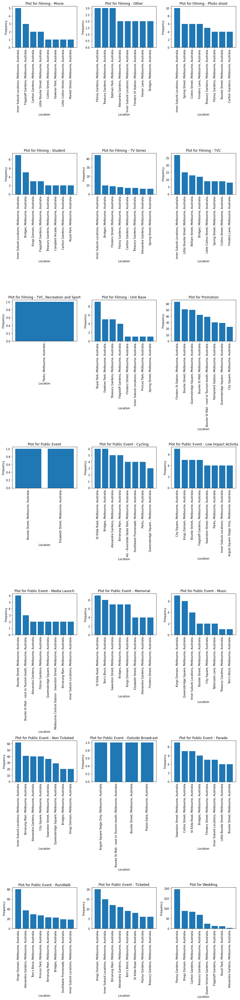

In [1009]:
top_locations={}
fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(12, 50))

# Flatten the axes array to iterate over all subplots
axes = axes.flatten()

location_counts = X_train.groupby(['Category', 'Location']).size().reset_index(name='Frequency')

#top 8 locations for each event
Z=location_counts.groupby('Category')
num=0
for i in Z:
    cat=i[0]
    df=pd.DataFrame(i[1])
    df=df.sort_values(by='Frequency', ascending=False)
    top_x=df['Location'][:8].values
    top_y=df['Frequency'][:8].values
    
    top_locations[cat]=top_x
    
    ax = axes[num]
    # Your plotting code here using group_data
    ax.bar(top_x, top_y, label=cat)
    ax.set_title(f'Plot for {cat}')
    ax.set_xlabel('Location')
    ax.set_ylabel('Frequency')
    ax.set_xticks(top_x)
    ax.set_xticklabels(top_x,rotation=90)
    num+=1
    

plt.tight_layout()
plt.show()

In [1010]:
# Loc_train=X_train['Location']
X_train_1=X_train.drop(['Location'],axis=1)
# Loc_test=X_test['Location']
X_test_1=X_test.drop(['Location'],axis=1)

In [1011]:
binary_encoder = BinaryEncoder(cols=['Category'])

# Fit and transform the DataFrame
binary_encoder.fit(X_train_1)
X_train_1=binary_encoder.transform(X_train_1)
X_test_1=binary_encoder.transform(X_test_1)

In [1012]:
X_train_1.head()

,Category_0,Category_1,Category_2,Category_3,Category_4,Start_ordinal,End_ordinal,Duration
123,0,0,0,0,1,736297,736298,1
3193,0,0,0,1,0,736322,736332,10
3111,0,0,0,1,0,735893,735897,4
1325,0,0,0,1,1,736671,736678,7
2413,0,0,0,1,0,735652,735674,22


In [1013]:
col_names = X_train_1.columns

scaler = MinMaxScaler()
scaler.fit(X_train_1[col_names])
scaled_train = scaler.transform(X_train_1[col_names])
X_train_scaled = pd.DataFrame(scaled_train, columns=col_names)

scaled_test = scaler.transform(X_test_1[col_names])
X_test_scaled = pd.DataFrame(scaled_test, columns=col_names)


In [1014]:
X_train_scaled.head()

,Category_0,Category_1,Category_2,Category_3,Category_4,Start_ordinal,End_ordinal,Duration
0,0.0,0.0,0.0,0.0,1.0,0.717949,0.704244,0.002778
1,0.0,0.0,0.0,1.0,0.0,0.734818,0.726790,0.027778
2,0.0,0.0,0.0,1.0,0.0,0.445344,0.438329,0.011111
3,0.0,0.0,0.0,1.0,1.0,0.970310,0.956233,0.019444
4,0.0,0.0,0.0,1.0,0.0,0.282726,0.290451,0.061111


<b>KNeighborsRegressor is used to find the neighbors for a data point. The neighbors can be used to suggest the locations for specific category of event</b>

In [1015]:
knn_model_event = KNeighborsRegressor(n_neighbors=8) #8 neighbors are considered
knn_model_event.fit(X_train_scaled, Y_train)  

Y_pred = knn_model_event.predict(X_test_scaled)

mse = mean_squared_error(Y_test, Y_pred)
print("Mean Squared Error:", mse)

Mean Squared Error: 0.011074081590402705


In [1016]:
X_train.index=X_train_scaled.index

In [1017]:
X_test.index=X_test_scaled.index

In [1018]:
Y_train.index=X_train_scaled.index

In [1019]:
Y_test.index=X_test_scaled.index

<b>Obtaining the neighbors and neighbors' locations for X_test and finding the number of times the top locations were selected for a given event</b> 

In [1021]:
count_dict={}
neighbour_dict={'Category':[],'Latitude':[],'Longitude':[],'Location':[]}



distances, indices = knn_model_event.kneighbors(X_test_scaled)
for i in range(len(X_test_scaled)):
    per=0

    neighbor_indices = indices[i]
#     if X_test['Location'][i] in X_train.iloc[neighbor_indices,4].values:
#         per+=1
    # Print the indices and distances of the neighbors
    #print(X_test['Category'][i],"--->",X_test['Location'][i],"--->",X_test['Duration'][i])
    for j in neighbor_indices:
        #print(X_train['Category'][j],"--->",X_train['Location'][j])
        neighbour_point=X_train.iloc[j]
        category=neighbour_point['Category']
        loc=neighbour_point['Location']
        
        neighbour_dict['Category'].append(category)
        neighbour_dict['Latitude'].append(Y_train.iloc[j]['Latitude'])
        neighbour_dict['Longitude'].append(Y_train.iloc[j]['Longitude'])
        neighbour_dict['Location'].append(loc)

        
        if loc in top_locations[category]:
            per+=1
    if category not in count_dict:
        count_dict[category]=[(per/8)*100]
    else:
        count_dict[category].append((per/8)*100)
        


In [1023]:
neighbour_df=pd.DataFrame(neighbour_dict)
neighbour_df.head()

,Category,Latitude,Longitude,Location
0,Public Event - Media Launch,-37.811426,144.964280,"Bourke St Mall - next to Tourism booth, Melbou..."
1,Public Event - Media Launch,-37.811426,144.964280,"Bourke St Mall - next to Tourism booth, Melbou..."
2,Public Event - Media Launch,-37.816049,144.957055,"Bourke Street, Melbourne, Australia"
3,Public Event - Media Launch,-37.808823,144.966208,"La Trobe Street, Melbourne, Australia"
4,Public Event - Media Launch,-38.125974,145.331400,"Swanston Street, Melbourne, Australia"


In [981]:
print("The top locations were selected on average: ")
for i,j in count_dict.items():
    avg=round(sum(j)/len(j),2)
    percentage_in_train=round(X_train['Category'].value_counts().loc[i]/len(X_train)*100,2)
    variation=sum(location_counts['Category']==i)
    print(f"{avg}% of times under {i}-({percentage_in_train}%,{variation}) Category")

The top locations were selected on average: 
46.15% of times under Public Event - Media Launch-(1.23%,26) Category
95.45% of times under Filming - Unit Base-(0.82%,9) Category
99.8% of times under Wedding-(14.24%,11) Category
40.97% of times under Filming - TVC-(7.65%,86) Category
74.33% of times under Promotion-(12.84%,33) Category
63.3% of times under Public Event - Run/Walk-(12.49%,46) Category
38.32% of times under Public Event - Non Ticketed-(22.09%,112) Category
40.0% of times under Public Event - Low Impact Activity-(2.71%,45) Category
60.58% of times under Public Event - Cycling-(1.75%,24) Category
36.79% of times under Public Event - Ticketed-(5.37%,52) Category
68.75% of times under Public Event - Memorial-(2.07%,20) Category
68.33% of times under Public Event - Music-(1.08%,20) Category
40.25% of times under Filming - TV Series-(6.24%,60) Category
32.39% of times under Filming - Photo shoot-(3.38%,53) Category
55.0% of times under Filming - Student-(1.63%,34) Category
75.0% 

#### PARKING

In [949]:
parking_df.head()

,lastupdated,status_timestamp,zone_number,status_description,kerbsideid,location
0,2023-12-14T04:45:34+00:00,2023-12-14T03:41:25+00:00,7695.0,Unoccupied,22959,"-37.81844776554182, 144.95938672872117"
1,2023-12-14T04:45:34+00:00,2023-12-13T06:21:58+00:00,7939.0,Unoccupied,10136,"-37.8099909364941, 144.95263753679632"
2,2023-12-14T04:45:34+00:00,2023-12-13T07:44:31+00:00,NaN,Unoccupied,6992,"-37.81898459198334, 144.95965213010888"
3,2023-12-14T23:45:34+00:00,2023-12-14T23:35:02+00:00,NaN,Unoccupied,6527,"-37.81060096851364, 144.95642622505966"
4,2023-12-14T23:45:34+00:00,2023-12-14T22:39:46+00:00,NaN,Unoccupied,6526,"-37.810581463657826, 144.95649292476088"


In [950]:
parking_df.shape

(6231, 6)

In [951]:
parking_df.nunique()

lastupdated             29
status_timestamp      5530
zone_number            513
status_description       2
kerbsideid            6231
location              5865
dtype: int64

In [952]:
parking_lat=[]
parking_lon=[]

for i in parking_df['location']:
    x,y=i.split(",")
    parking_lat.append(Decimal(x.strip()))
    parking_lon.append(Decimal(y.strip()))

In [953]:
parking_df['Latitude']=parking_lat
parking_df['Longitude']=parking_lon
parking_df.head()

,lastupdated,status_timestamp,zone_number,status_description,kerbsideid,location,Latitude,Longitude
0,2023-12-14T04:45:34+00:00,2023-12-14T03:41:25+00:00,7695.0,Unoccupied,22959,"-37.81844776554182, 144.95938672872117",-37.81844776554182,144.95938672872117
1,2023-12-14T04:45:34+00:00,2023-12-13T06:21:58+00:00,7939.0,Unoccupied,10136,"-37.8099909364941, 144.95263753679632",-37.8099909364941,144.95263753679632
2,2023-12-14T04:45:34+00:00,2023-12-13T07:44:31+00:00,NaN,Unoccupied,6992,"-37.81898459198334, 144.95965213010888",-37.81898459198334,144.95965213010888
3,2023-12-14T23:45:34+00:00,2023-12-14T23:35:02+00:00,NaN,Unoccupied,6527,"-37.81060096851364, 144.95642622505966",-37.81060096851364,144.95642622505966
4,2023-12-14T23:45:34+00:00,2023-12-14T22:39:46+00:00,NaN,Unoccupied,6526,"-37.810581463657826, 144.95649292476088",-37.810581463657826,144.95649292476088


In [954]:
parking_df.isna().sum()

lastupdated             0
status_timestamp        0
zone_number           464
status_description      0
kerbsideid              0
location                0
Latitude                0
Longitude               0
dtype: int64

In [955]:
locations_without_zone=parking_df.loc[parking_df['zone_number'].isna(),['Latitude','Longitude']]
for i in range(len(parking_df)):
    if np.isnan(parking_df.iloc[i,2]):
        if parking_df.iloc[i,6] in locations_without_zone['Latitude'] and parking_df.iloc[i,7] in locations_without_zone['Longitude']:
            print(i)




In [956]:
# parking_df.drop(['status_description'],axis=1,inplace=True)


In [959]:
parking_df.drop(['kerbsideid','lastupdated','status_timestamp','status_description','zone_number','location'],axis=1,inplace=True)


In [960]:
parking_df.head()

,Latitude,Longitude
0,-37.81844776554182,144.95938672872117
1,-37.8099909364941,144.95263753679632
2,-37.81898459198334,144.95965213010888
3,-37.81060096851364,144.95642622505966
4,-37.810581463657826,144.95649292476088


In [1040]:
col_names = parking_df.columns

scaler = MinMaxScaler()
scaler.fit(parking_df[col_names])
scaled_train = scaler.transform(parking_df[col_names])
parking_scaled = pd.DataFrame(scaled_train, columns=col_names)

neighbour_scaled_df=pd.DataFrame(scaler.transform(neighbour_df[['Latitude','Longitude']]),columns=['Latitude','Longitude'])

In [1041]:
parking_scaled.head()

,Latitude,Longitude
0,0.558579,0.439876
1,0.717148,0.310522
2,0.548514,0.444962
3,0.705710,0.383135
4,0.706076,0.384413


In [1042]:
neighbour_scaled_df.head()

,Latitude,Longitude
0,0.690246,0.533656
1,0.690246,0.533656
2,0.603557,0.395182
3,0.739040,0.570619
4,-5.207662,7.569805


In [1026]:

knn_model_parking = NearestNeighbors(n_neighbors=8, algorithm='auto')
knn_model_parking.fit(parking_scaled)


NearestNeighbors(n_neighbors=8)

In [ ]:
distances, indices = knn_model_parking.kneighbors(neighbour_scaled_df)

parking_neighbour_dict={'Latitude':[],'Longitude':[]}

for i in range(len(neighbour_scaled_df)):
    neighbour_indices = indices[i]
    for j in neighbour_indices:
        parking_neighbour=parking_df.iloc[j]
        parking_lat=parking_neighbour['Latitude']
        parking_lon=parking_neighbour['Longitude']
        parking_neighbour_dict['Latitude'].append(parking_lat)
        parking_neighbour_dict['Longitude'].append(parking_lon)

parking_neighbour_df=pd.DataFrame(parking_neighbour_dict)  
parking_neighbour_df.head()

In [128]:
mymap = folium.Map(location=[parking_df['Latitude'].mean(), parking_df['Longitude'].mean()], zoom_start=10)

# Add markers for each location
for index, row in parking_df.iterrows():

    folium.Marker([row['Latitude'], row['Longitude']], popup=row['kerbsideid'],icon=folium.Icon("red"),icon_size=(3, 3)).add_to(mymap)

for index, row in events_lat_lon.iterrows():

    folium.Marker([row['Latitude'], row['Longitude']], popup=row['Location'],icon=folium.Icon("blue")).add_to(mymap)

# Save the map as an HTML file
from IPython.display import display
display(mymap)